# All steps for downloading preprocessing data, growing, analyzing and plotting networks
## Project: Data-driven bicycle networks

This notebook downloads bicycle and street network data sets and prepares them for analysis.

Contact: Michael Szell (michael.szell@gmail.com)  
Created: 2020-06-09  
Last modified: 2021-03-10

## Preliminaries

### Parameters

In [517]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

Loaded parameters.



### Setup

In [ ]:
%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

In [497]:
%run -i functions.py

Loaded functions.



## Download and wrangle data

### Networks

In [ ]:
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    if placeinfo["nominatimstring"] != '':
        location = ox.geocoder.geocode_to_gdf(placeinfo["nominatimstring"])
        location = fill_holes(extract_relevant_polygon(placeid, shapely.geometry.shape(location['geometry'][0])))
        if debug: # Draw location polygons and their holes
            try:
                color = cm.rainbow(np.linspace(0,1,len(location)))
                for poly,c in zip(location, color):
                    plt.plot(*poly.exterior.xy, c = c)
                    for intr in poly.interiors:
                        plt.plot(*intr.xy, c = "red")
            except:
                plt.plot(*location.exterior.xy)
            plt.show()
    else:
        # https://gis.stackexchange.com/questions/113799/how-to-read-a-shapefile-in-python
        shp = fiona.open(PATH["data"] + placeid + "/" + placeid + ".shp")
        first = next(iter(shp))
        location = shapely.geometry.shape(first['geometry'])
    
    Gs = {}
    for parameterid, parameterinfo in tqdm(osmnxparameters.items(), desc = "Networks", leave = False):
        for i in range(0,10): # retry
            try:
                Gs[parameterid] = ox.graph_from_polygon(location, 
                                       network_type = parameterinfo['network_type'],
                                       custom_filter = (parameterinfo['custom_filter']),
                                       retain_all = parameterinfo['retain_all'],
                                       simplify = False)
            except ValueError:
                Gs[parameterid] = nx.empty_graph(create_using = nx.MultiDiGraph)
                print(placeid + ": No OSM data for graph " + parameterid + ". Created empty graph.")
                break
            except ConnectionError or UnboundLocalError:
                print("ConnectionError or UnboundLocalError. Retrying.")
                continue
            except:
                print("Other error. Retrying.")
                continue
            break
        if parameterinfo['export']: ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
         
    # Compose special cases biketrack, bikeable, biketrackcarall
    parameterid = 'biketrack'
    Gs[parameterid] = nx.compose_all([Gs['bike_cyclewaylefttrack'], Gs['bike_cyclewaytrack'], Gs['bike_highwaycycleway'], Gs['bike_bicycleroad'], Gs['bike_cyclewayrighttrack'], Gs['bike_designatedpath'], Gs['bike_cyclestreet']])
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid+ "/", placeid, parameterid)
    
    parameterid = 'bikeable'
    Gs[parameterid] = nx.compose_all([Gs['biketrack'], Gs['car30'], Gs['bike_livingstreet']]) 
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
    
    parameterid = 'biketrackcarall'
    Gs[parameterid] = nx.compose(Gs['biketrack'], Gs['carall']) # Order is important
    ox_to_csv(Gs[parameterid], PATH["data"] + placeid + "/", placeid, parameterid)
    
    print([k for k in Gs ])
    
    for parameterid in networktypes[:-2]:
        #G_temp = nx.MultiDiGraph(ox.utils_graph.get_digraph(ox.simplify_graph(Gs[parameterid]))) # This doesnt work - cant get rid of multiedges
        ox_to_csv(ox.simplify_graph(Gs[parameterid]), PATH["data"] + placeid + "/", placeid, parameterid, "_simplified")
   

In [347]:
# Compress all data files (will not do anything if files were compressed already)
for folder, subfolders, files in os.walk(PATH["data"]):
    for file in files:
        if file.endswith('es.csv'):
            compress_file(folder + "/", file.split(".")[0])

# Add population density data

In [349]:
CPH = [53644, 53648, 53649, 53650, 53651, 53653, 53654, 53655, 54037, 54038, 54039, 54040, 54041, 54042, 54043, 54044, 54045, 54046, 54047, 54048, 54049, 54050, 54051, 54052, 54053, 54054, 54055, 54435, 54436, 54437, 54438, 54439, 54440, 54441, 54442, 54443, 54444, 54445, 54446, 54447, 54448, 54449, 54450, 54451, 54452, 54453, 54454, 54835, 54836, 54837, 54838, 54839, 54840, 54841, 54842, 54843, 54844, 54845, 54846, 54847, 54848, 54849, 54850, 54851, 54852, 54853, 55239, 55240, 55241, 55242, 55243, 55244, 55245, 55246, 55247, 55248, 55249, 55250, 55251, 55252, 55253, 55254, 55255, 55256, 55633, 55634, 55635, 55636, 55637, 55638, 55639, 55640, 55641, 55642, 55643, 55644, 55645, 55646, 55647, 55648, 55649, 55650, 55651, 55652, 55653, 56026, 56027, 56028, 56029, 56030, 56031, 56032, 56033, 56034, 56035, 56036, 56037, 56038, 56039, 56040, 56041, 56042, 56043, 56044, 56419, 56420, 56421, 56422, 56423, 56424, 56425, 56426, 56427, 56428, 56429, 56430, 56431, 56432, 56433, 56434, 56435, 56436, 56437, 56438, 56439, 56821, 56822, 56823, 56824, 56825, 56826, 56827, 56828, 56829, 56830, 56831, 56832, 56833, 56834, 56835, 56836, 56837, 56838, 56839, 56840, 57223, 57224, 57225, 57226, 57227, 57228, 57229, 57230, 57231, 57232, 57233, 57234, 57235, 57236, 57237, 57238, 57239, 57240, 57241, 57242, 57243, 57623, 57624, 57625, 57626, 57627, 57628, 57629, 57630, 57631, 57632, 57633, 57634, 57635, 57636, 57637, 57638, 57639, 57640, 57641, 57642, 58024, 58025, 58026, 58027, 58028, 58029, 58030, 58031, 58032, 58033, 58034, 58035, 58036, 58037, 58038, 58438, 58439, 58440, 58441, 58442, 58850, 58851, 58852, 58855, 58856, 58857, 58858, 58859, 59271, 59272, 59273, 59274, 59278]

In [ ]:


networktypes = ['biketrack',
 'carall',
 'bikeable',
 'biketrackcarall']

for networktype in networktypes:
    print(networktype)
    i=0
#    nDict = {}
    nDict2 = {}
    for i in range(len(pop_den_df)):
        n = ox.distance.get_nearest_node(Gs[networktype], [pop_den_df.iloc[i].lat,pop_den_df.iloc[i].long])
        if haversine([pop_den_df.iloc[i].lat,pop_den_df.iloc[i].long], (Gs[networktype].nodes[n]["y"], Gs[networktype].nodes[n]["x"]), unit="m") <= snapthreshold:
            #nDict = {**nDict, n: pop_den_df.iloc[i].pop_den_attr}
            nDict2 = {**nDict2, n: pop_den_df.iloc[i].pop_den}
            i+=1
            print(i) 
            
    nx.set_edge_attributes(Gs[networktype], 0.0, 'pop_den')
    #nx.set_edge_attributes(Gs[networktype], 0.0, 'pop_den_attr')
    
    for e in Gs[networktype].edges():
        a,b=e
        lat = Gs[networktype].nodes[a]["y"]
        long = Gs[networktype].nodes[a]["x"]
        #eDistDict = {}
        eDistDict2 = {}
    
        for n in nDict2:
            y = Gs[networktype].nodes[n]["y"]
            x = Gs[networktype].nodes[n]["x"]
            dist = haversine([lat,long], (y,x), unit="m")
            #eDistDict = {**eDistDict, dist:nDict[n]}
            eDistDict2 = {**eDistDict2, dist:nDict2[n]}
    
        #minDist = min(eDistDict.keys())
        minDist2 = min(eDistDict2.keys()) 
        pop_den = eDistDict2[minDist2]
        #popDenAttr = eDistDict[minDist]
        #edgelength = Gs[networktype].get_edge_data(a,b,0)['length']
        #pop_den_attr = popDenAttr * edgelength
        
        nx.set_edge_attributes(Gs[networktype], {(a,b,0): {"pop_den": pop_den }})
        #nx.set_edge_attributes(Gs[networktype], {(a,b,0): {"pop_den_attr": pop_den_attr }})
        
    ox_to_csv(Gs[networktype], PATH["data"] + 'copenhagen' + "/", 'copenhagen', networktype)
    ox_to_csv(ox.simplify_graph(Gs[networktype]), PATH["data"] + 'copenhagen' + "/", 'copenhagen', networktype, "_simplified")
    ox.save_graphml(Gs[networktype], "../../bikenwgrowth_external/data/copenhagen/bikedata/G_"+networktype+"_graphml.graphml")
    
    
        
    

# Add bicycle-count data

In [ ]:
#We create a variable for unassigned edges, 
# which is the average edgelength multiplied with the average fraction of bikecounts in the network
G_carall = copy.deepcopy(Gs['carall'])

count_df = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/bikedata/bicycle_counts.csv")

count_df = count_df[count_df.year ==2019]

#G_carall = ox.load_graphml('../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml')

bcount_unassigned = count_df['bicycle_count'].mean()

nx.set_edge_attributes(G_carall, 0.0, 'bcount')

for i in range(len(count_df)):
    ne = ox.distance.get_nearest_edge(G_carall, [count_df.iloc[i].lat,count_df.iloc[i].long])
    nx.set_edge_attributes(G_carall, {ne: {'bcount': count_df.iloc[i].bicycle_count }})
    
bcount_dict = nx.get_edge_attributes(G_carall, "bcount")

ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")


with zipfile.ZipFile("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.zip", 'r') as zip_ref:
    zip_ref.extractall("../../bikenwgrowth_external/data/copenhagen/")

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

GG_carall = copy.deepcopy(G_carall)

edges = pd.read_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

#We take only assigned edges
edges1 = edges[edges.bcount !=0.0]

#we remove unnecessery data

edges2 = edges1

#we apply the mean of bikecounts for all assigned streets, by grouping on the street name and calculating the mean.
edges3 = edges2.groupby('name')['bcount'].mean().to_frame()

#renaming this column
edges3 = edges3.rename(columns={"bcount": "mean_group_bcount"})

#the initial edges are joined with the new generalised counts
result = pd.merge(edges,edges3,on='name',how = 'left')

result.to_csv("../../bikenwgrowth_external/data/copenhagen/copenhagen_carall_edges.csv")

compress_file("../../bikenwgrowth_external/data/copenhagen/","copenhagen_carall_edges")

result2 = result

#we apply the 'bcount_attr' the the result2 dataframe, representing all edges in the carall network.
# for edges that 'still' do not have a bikecount, a standard value is assigned 'bcount_attr_unassigned',
# otherwise the new mean fraction of bikecounts for each edge, is multiplied with the length of this edge.
# For now we lost the original fraction of bikecounts for assigned edges, but we will add them back in next step.
for i in range(len(result2)):
    num = result2['mean_group_bcount'].iloc[i]
    #if num is NaN
    if num != num:
        result2['mean_group_bcount'].iloc[i]= bcount_unassigned
    else:
        result2['mean_group_bcount'].iloc[i]= num 

# The new results are added to the carall network,
i=-1
for e in GG_carall.edges():
    i+=1
    a,b=e
    old_bcount = GG_carall.get_edge_data(a,b,0)['bcount']
    # if the edge is initially unassigned in the network we check if a generalised mean value of the whole street, 
    #belonging to this street exist, otherwise a standard value is given. If an edge is initially assigned a bikecount
    # we assign it the bcount_attr again, represented as edgelength multiplied by the fraction of bikecounts.
    if old_bcount ==0.0:
        if  result2['mean_group_bcount'].iloc[i] == bcount_unassigned:
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": bcount_unassigned }})
        else:
            mean_group_count = result2['mean_group_bcount'].iloc[i]
            nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": mean_group_count }})
    else:
        nx.set_edge_attributes(GG_carall, {(a,b,0): {"bcount": old_bcount }})

bcount_dict = nx.get_edge_attributes(GG_carall, "bcount")

bcount_mean = statistics.mean([float(k) for k in bcount_dict.values()])

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/mean_bcount.pkl', 'wb') as f:
    pickle.dump(bcount_mean, f)


ox_to_csv(GG_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(GG_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(GG_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")

with open('../../bikenwgrowth_external/data/copenhagen/bikedata/edges_dict_bcount.pkl', 'wb') as f:
    pickle.dump(bcount_dict, f)




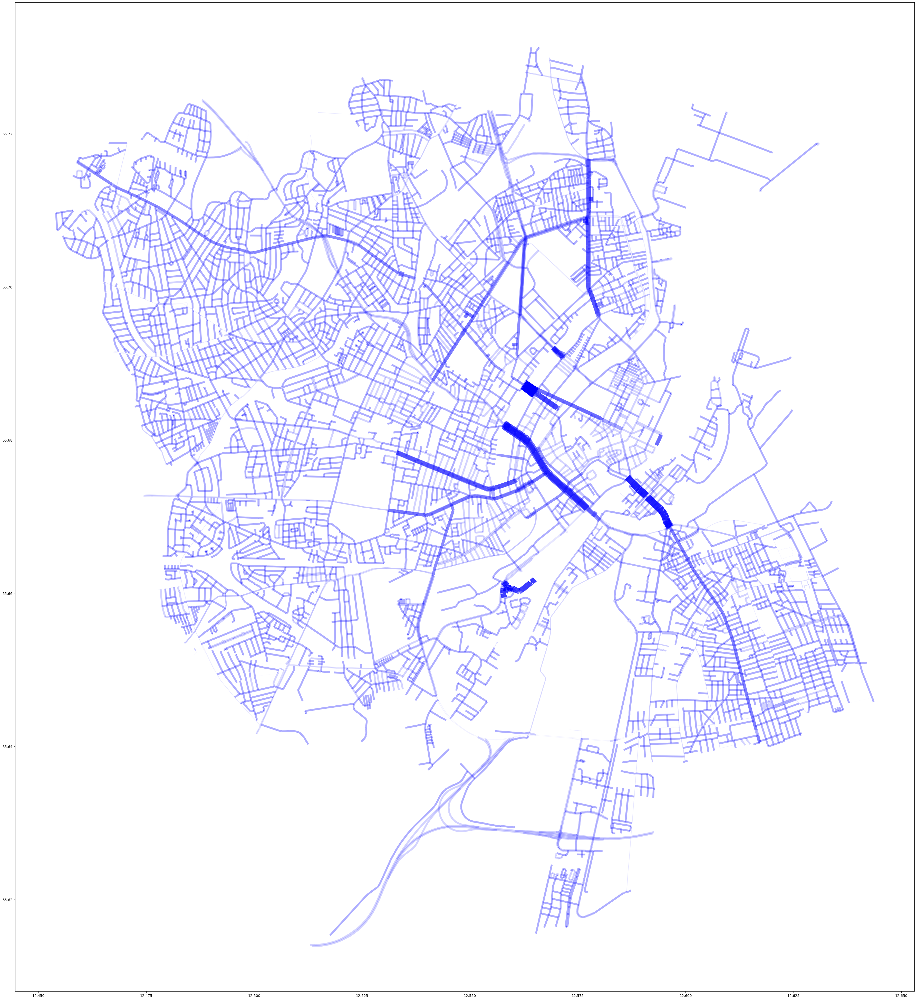

In [361]:
bcount_dictt = normalise_edge_dict(bcount_dict.copy())
#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [ 0.04 if bcount_dictt[k] == 0.17367075079201497 else bcount_dictt[k]  for k in bcount_dictt]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [bcount_dictt[k]*30 if (bcount_dictt[k] != 0.17367075079201497) else 1.5 for k in bcount_dictt]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

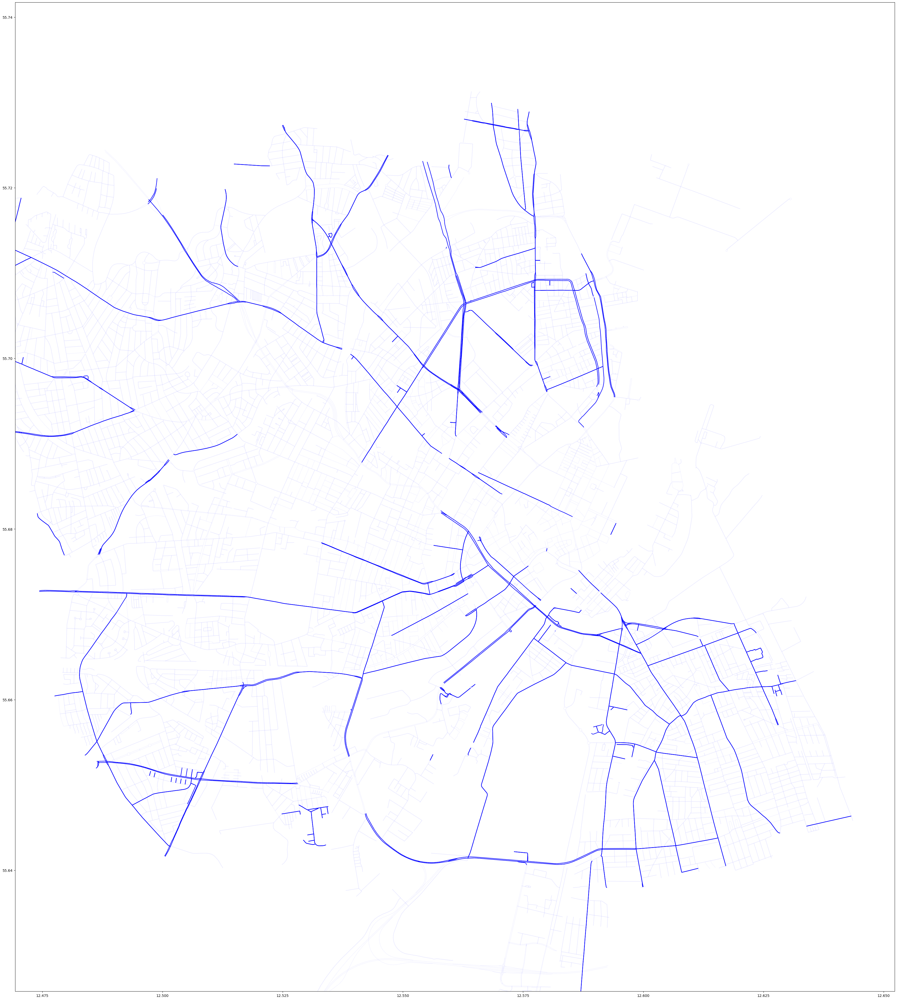

In [362]:
lanes = ox.graph_to_gdfs(GG_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ac = [0.04 if (bcount_dict[k]) == bcount_unassigned else 1.0 for k in bcount_dict]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac)
#bikelanes2.plot(ax=ax, color='red', alpha = 0.3,linestyle=(0,(5,10)))



plt.axis([12.469380, 12.652281, 55.625802, 55.741728])


plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


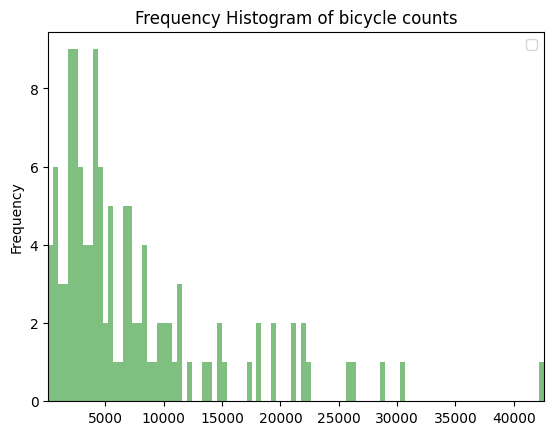

In [507]:
df_to_histogram(count_df['bicycle_count'], 'bicycle counts')

In [ ]:
# alpha zero er pop_den_attr
#aplha_one er bcount_attr

# Apply weighted distance attributes

In [448]:
# alpha zero er pop_den_attr
#aplha_one er bcount_attr
G_carall = copy.deepcopy(GG_carall)

length = list(nx.get_edge_attributes(G_carall, 'length').values())
bcount = list(nx.get_edge_attributes(G_carall, 'bcount').values())
pop_den = list(nx.get_edge_attributes(G_carall, 'pop_den').values())

#Normalise values and convert to fraction
length_norm = normalise_list(length.copy())
bcount_frac_norm = normalise_list([1/bcount[i] for i in range(len(bcount))])
pop_den_frac_norm = normalise_list([1/pop_den[i] for i in range(len(pop_den))])

#create df with all attributes
edge_attributes = pd.DataFrame({'length':lengths, 'length_norm':length_norm, 'bcount_frac': bcount_frac_norm, 'pop_den_frac': pop_den_frac_norm})


#create weighted distance measures and normalise these
edge_attributes['alpha_zero'] = normalise_list(0* (edge_attributes['length']*edge_attributes['bcount_frac']) + (1-0)*(edge_attributes['length']*edge_attributes['pop_den_frac']))
edge_attributes['alpha_half'] = normalise_list(0.5* (edge_attributes['length']*edge_attributes['bcount_frac']) + (0.5)*(edge_attributes['length']*edge_attributes['pop_den_frac']))
edge_attributes['alpha_one'] = normalise_list(1* (edge_attributes['length']*edge_attributes['bcount_frac']) + (0)*(edge_attributes['length']*edge_attributes['pop_den_frac']))

# apply to G_carall graph as attributes
i=-1
for e in G_carall.edges():
    i+=1
    a,b=e
    length_norm = edge_attributes['length_norm'].iloc[i]
    alpha_zero = edge_attributes['alpha_zero'].iloc[i]
    alpha_half = edge_attributes['alpha_half'].iloc[i]
    alpha_one = edge_attributes['alpha_one'].iloc[i]
    nx.set_edge_attributes(G_carall, {(a,b,0): {"length_norm": length_norm}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"pop_den_attr": alpha_zero}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_pop_den_attr": alpha_half}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_attr": alpha_one}})

#save graph
ox_to_csv(G_carall, PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall')

ox_to_csv(ox.simplify_graph(G_carall), PATH["data"] + 'copenhagen' + "/", 'copenhagen', 'carall', "_simplified")

ox.save_graphml(G_carall, "../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml")



# Routing

In [ ]:
#mangler lige at lave folder til attr

for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
    print(placeid + ": Generating networks")

    # Load networks
    #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    for attr in attrlist:
        G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall', attr)

        # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]

        # Generation
        (GTs, GT_abstracts) = greedy_triangulation_routing(G_carall, nnids, prune_quantiles, prune_measure)
        (MST, MST_abstract) = mst_routing(G_carall, nnids)

        # Write results
        results = {"placeid": placeid, "prune_measure": prune_measure, "poi_source": poi_source, "prune_quantiles": prune_quantiles, "GTs": GTs, "GT_abstracts": GT_abstracts, "MST": MST, "MST_abstract": MST_abstract}
        write_result(results, "pickle", placeid, poi_source, prune_measure, "_"+ attr + ".pickle")

# Analysis

In [ ]:
debug = False # If True, will produce plots and/or verbose output to double-check
rerun_existing = False # If True, will re-run the costly analysis of existing infra even if files already exist.
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv



### Functions

%run -i functions.py

In [ ]:
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing existing infrastructure.")
    
    # output_place is one static file for the existing city. This can be compared to the generated infrastructure.
    # Make a check if this file was already generated - it only needs to be done once. If not, generate it:
    filename = placeid + "_existing.csv"
    if rerun_existing or not os.path.isfile(PATH["results"] + placeid + "/" + filename):
        empty_metrics = {
                         "length":0,
                         "length_lcc":0,
                         "coverage": 0,
                         "directness": 0,
                         "directness_lcc": 0,
                         "poi_coverage": 0,
                         "components": 0,
                         "pop_den_length":0,
                         "efficiency_global": 0,
                        
                         "efficiency_global_routed": 0,
                
                         "directness_lcc_linkwise": 0,
                         "directness_all_linkwise": 0
                        }
        output_place = {}
        for networktype in networktypes:
            output_place[networktype] = copy.deepcopy(empty_metrics)

        # Analyze all networks     
        Gs = {}
        for networktype in networktypes:
            if networktype != "biketrack_onstreet" and networktype != "bikeable_offstreet":
                graph = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)
                Gs[networktype] = graph
                graph_simplified = simplify_ig(graph)
                Gs[networktype + "_simplified"] = graph_simplified
                #Gs[networktype] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype)
                #Gs[networktype + "_simplified"] = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, networktype + "_simplified")
            elif networktype == "biketrack_onstreet":
                graph_biketrack = Gs["biketrack"]
                graph_carall =Gs["carall"]
                Gs[networktype] = intersect_igraphs(graph_biketrack, graph_carall)
                Gs[networktype + "_simplified"] = intersect_igraphs(simplify_ig(graph_biketrack), simplify_ig(graph_carall))
            elif networktype == "bikeable_offstreet":
                G_temp = copy.deepcopy(Gs["bikeable"])
                delete_overlaps(G_temp, Gs["carall"])
                Gs[networktype] = G_temp
                G_temp = copy.deepcopy(simplify_ig(Gs["bikeable"]))
                delete_overlaps(G_temp, Gs["carall_simplified"])
                Gs[networktype + "_simplified"] = G_temp

        
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]

            
        covs = {}
        for networktype in tqdm(networktypes, desc = "Networks", leave = False):
            if debug: print(placeid + ": Analyzing results: " + networktype)
            metrics, cov = calculate_metrics(Gs[networktype], Gs[networktype + "_simplified"], Gs['carall'], nnids, empty_metrics, buffer_walk, numnodepairs, debug)
            #metrics, cov = calculate_metrics_custom(Gs[networktype], Gs[networktype + "_simplified"], Gs['carall'], nnids, empty_metrics, buffer_walk, numnodepairs, debug)
            
            for key, val in metrics.items():
                output_place[networktype][key] = val
            covs[networktype] = cov
        # Save the covers
        write_result(covs, "pickle", placeid, "", "", "existing_covers.pickle")
        
        # Write to CSV
        write_result(output_place, "dictnested", placeid, "", "", "existing.csv", empty_metrics)

In [ ]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['length']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    

    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

In [ ]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['bcount_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

In [ ]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['pop_den_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    

    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

In [ ]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = [ 'bcount_pop_den_attr']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
        

    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

In [ ]:
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

### Setup

%run -i path.py
#%run -i setup.py
%run -i setupCPH.py

%load_ext watermark
%watermark -n -v -m -g -iv
import statistics

### Functions

%run -i functions.py

attrlist = ['length_norm']


for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Analyzing results")

# Load networks
    
    
    
    for attr in attrlist:
        print("attr: " + attr)
        
        G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
        Gexisting = {}
        for networktype in ["biketrack", "bikeable"]:
            Gexisting[networktype] = csv_to_ig(PATH["data"] + placeid + "/", placeid, networktype)



    # Load POIs
        with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
            nnids = [int(line.rstrip()) for line in f]
    # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+ attr
        resultfile = open(PATH["results"] + placeid + "/" + filename  +".pickle",'rb')
        res = pickle.load(resultfile)
        resultfile.close()
        if debug: pp.pprint(res)
        # Calculate
        # output contains lists for all the prune_quantile values of the corresponding results
        #output, covs = calculate_metrics_additively_custom(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        #output_MST, cov_MST = calculate_metrics_custom(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        output, covs = calculate_metrics_additively(res["GTs"], res["GT_abstracts"], res["prune_quantiles"], G_carall, nnids, buffer_walk, numnodepairs, debug, True, Gexisting)
        output_MST, cov_MST = calculate_metrics(res["MST"], res["MST_abstract"], G_carall, nnids, output, buffer_walk, numnodepairs, debug, True, ig.Graph(), Polygon(), False, Gexisting)

        # Save the covers
        write_result(covs, "pickle", placeid, poi_source, prune_measure,  "_"+ attr+"_covers.pickle")
    #     write_result(covs_carminusbike, "pickle", placeid, poi_source, prune_measure, "_covers_carminusbike.pickle")
        write_result(cov_MST, "pickle", placeid, poi_source, prune_measure, "_"+ attr+"_cover_mst.pickle")

        # Write to CSV
        write_result(output, "dict", placeid, poi_source, prune_measure, "_"+ attr+".csv")
    #     write_result(output_carminusbike, "dict", placeid, poi_source, prune_measure, "_carminusbike.csv")
    #     write_result(output_carconstrictedbike, "dict", placeid, poi_source, prune_measure, "_carconstrictedbike.csv")
        write_result(output_MST, "dict", placeid, poi_source, "",  attr+"_mst.csv")
        covs.clear()
        output.clear()
        output_MST.clear()
        Gexisting.clear()

# Plots

In [ ]:
debug = False # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"
plotconstricted = False # If True, will add plots about constricted street network metrics

### Setup

%run -i path.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv

### Functions

%run -i functions.py

In [ ]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting networks")
    
    if prune_measure == "betweenness":
        weight_abstract = True
    else:
        weight_abstract = 6

        # EXISTING INFRASTRUCTURE
        # Load networks
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    map_center = nxdraw(G_carall, "carall")

    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)

    fig = initplot()
    nxdraw(G_carall, "carall", map_center)
    nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
    plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_carall_poi_' + poi_source + '.pdf', bbox_inches="tight")
    plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_carall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
    plt.close()
    
    for attr in attrlist:
        print("attribute: "+attr)

        # GENERATED, POI BASED
        # Load results
       
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+attr+".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)
        if debug: pp.pprint(res)

        # PLOT abstract MST
        fig = initplot()
        nxdraw(G_carall, "carall", map_center)
        nxdraw(res["MST_abstract"], "abstract", map_center, weighted = 6)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+  "/" + placeid + '_MSTabstract_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstract_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT MST all together
        fig = initplot()
        nxdraw(G_carall, "carall")
        nxdraw(res["MST"], "bikegrown", map_center, nodesize = nodesize_grown)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTall_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT MST all together with abstract
        fig = initplot()
        nxdraw(G_carall, "carall", map_center)
        nxdraw(res["MST"], "bikegrown", map_center, nodesize = 0)
        nxdraw(res["MST_abstract"], "abstract", map_center, weighted = 6)
        nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
        nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in res["MST"].vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstractall_poi_' + poi_source + '.pdf', bbox_inches="tight")
        plt.savefig(PATH["plots_networks"] + placeid + "/"+attr+ "/" + placeid + '_MSTabstractall_poi_' + poi_source + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
        plt.close()

        # PLOT abstract greedy triangulation (this can take some minutes)
        for GT_abstract, prune_quantile in zip(res["GT_abstracts"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            try:
                GT_abstract.es["weight"] = GT_abstract.es["width"]
            except:
                pass
            nxdraw(GT_abstract, "abstract", map_center, drawfunc = "nx.draw_networkx_edges", nodesize = 0, weighted = weight_abstract, maxwidthsquared = nodesize_poi)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT_abstract.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid +"/"+attr+  "/" + placeid + '_GTabstract_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

        # PLOT all together (this can take some minutes)
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(GT, "bikegrown", map_center, nodesize = nodesize_grown)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid +"/"+attr+  "/" + placeid + '_GTall_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()


In [ ]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting networks")
    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)

    # EXISTING INFRASTRUCTURE
    # Load networks
    G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    G_biketrackcarall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrackcarall')
    G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')
    map_center = nxdraw(G_carall, "carall")
    
    for attr in attrlist:
        print(attr)
        # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure + "_"+attr+".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)


        # PLOT all together with overlaps (this can take some minutes)
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(G_biketrack, "biketrack", map_center, list(set([v["id"] for v in G_biketrack.vs]).intersection(set([v["id"] for v in G_carall.vs]))))
            nxdraw(GT, "bikegrown", map_center, nodesize = 0)
            nxdraw(GT, "highlight_biketrack", map_center, list(set([v["id"] for v in G_biketrack.vs]).intersection(set([v["id"] for v in GT.vs]))))
    #         nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
    #         nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" + attr+  "/" +placeid + '_GTalloverlapbiketrack_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()
            
        for GT, prune_quantile in zip(res["GTs"], res["prune_quantiles"]):
            fig = initplot()
            nxdraw(G_carall, "carall")
            nxdraw(G_bikeable, "bikeable", map_center, list(set([v["id"] for v in G_bikeable.vs]).intersection(set([v["id"] for v in G_carall.vs]))))
            nxdraw(GT, "bikegrown", map_center, nodesize = 0)
            nxdraw(GT, "highlight_bikeable", map_center, list(set([v["id"] for v in G_bikeable.vs]).intersection(set([v["id"] for v in GT.vs]))))
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" + attr+  "/" +placeid + '_GTalloverlapbikeable_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

In [ ]:
# %%capture
for placeid, placeinfo in tqdm(cities.items(), desc = "Cities"):
    print(placeid + ": Plotting network covers")

    # Load networks
    G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
    G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
    G_biketrackcarall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrackcarall')
    G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')
    map_center = nxdraw(G_carall, "carall")
    
    # Load POIs
    with open(PATH["data"] + placeid + "/" + placeid + '_poi_' + poi_source + '_nnidscarall.csv') as f:
        nnids = [int(line.rstrip()) for line in f]
    nodesize_poi = nodesize_from_pois(nnids)
    for attr in attrlist:

        # Load results
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".pickle"
        with open(PATH["results"] + placeid + "/" + filename, 'rb') as f:
            res = pickle.load(f)

        # Load covers
        filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ "_covers"
        with open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb') as f:
            covs = pickle.load(f)
        filename = placeid + "_"  + "existing_covers"
        with open(PATH["results"] + placeid + "/" + filename + ".pickle",'rb') as f:
            cov_car = pickle.load(f)['carall']

        # Construct and plot patches from covers
        patchlist_car, patchlist_car_holes = cov_to_patchlist(cov_car, map_center)
        for GT, prune_quantile, cov in zip(res["GTs"], res["prune_quantiles"], covs.values()):
            fig = initplot()

            # Covers
            axes = fig.add_axes([0, 0, 1, 1]) # left, bottom, width, height (range 0 to 1)
            patchlist_bike, patchlist_bike_holes = cov_to_patchlist(cov, map_center)

            # We have this contrived order due to alphas, holes, and matplotlib's inability to draw polygon patches with holes. This only works because the car network is a superset of the bike network.
            # car orange, bike white, bike blue, bike holes white, bike holes orange, car holes white
            patchlist_combined = patchlist_car + patchlist_bike + patchlist_bike + patchlist_bike_holes+ patchlist_bike_holes + patchlist_car_holes
            pc = PatchCollection(patchlist_combined)
            colors = np.array([[255/255,115/255,56/255,0.2] for _ in range(len(patchlist_car))]) # car orange
            if len(patchlist_bike):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_bike))], axis = 0) # bike white
                colors = np.append(colors, [[86/255,220/255,244/255,0.4] for _ in range(len(patchlist_bike))], axis = 0) # bike blue
            if len(patchlist_bike_holes):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_bike_holes))], axis = 0) # bike holes white
            if len(patchlist_bike_holes):
                colors = np.append(colors, [[255/255,115/255,56/255,0.2] for _ in range(len(patchlist_bike_holes))], axis = 0) # bike holes orange
            if len(patchlist_car_holes):
                colors = np.append(colors, [[1,1,1,1] for _ in range(len(patchlist_car_holes))], axis = 0) # car holes white
            pc.set_facecolors(colors)
            pc.set_edgecolors(np.array([[0,0,0,0.4] for _ in range(len(patchlist_combined))])) # remove this line if the outline of the full coverage should remain
            axes.add_collection(pc)
            axes.set_aspect('equal')
            axes.set_xmargin(0.01)
            axes.set_ymargin(0.01)
            axes.plot()

            # Networks
            nxdraw(G_carall, "carall", map_center)
            nxdraw(GT, "bikegrown", map_center, nodesize = nodesize_grown)
            nxdraw(G_carall, "poi_unreached", map_center, nnids, "nx.draw_networkx_nodes", nodesize_poi)
            nxdraw(G_carall, "poi_reached", map_center, list(set([v["id"] for v in GT.vs]).intersection(set(nnids))), "nx.draw_networkx_nodes", nodesize_poi)
            plt.savefig(PATH["plots_networks"] + placeid + "/" +attr+"/"+ placeid + '_GTallcover_poi_' + poi_source + "_" + prune_measures[prune_measure] + "{:.3f}".format(prune_quantile) + '.png', bbox_inches="tight", dpi=plotparam["dpi"])
            plt.close()

# Plot results

In [ ]:
debug = False # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"
plotconstricted = False # If True, will add plots about constricted street network metrics

### Setup

%run -i path.py
%run -i setupCPH.py
if not debug: # Only do this if sure the code is bug-free!
    warnings.filterwarnings('ignore')

%load_ext watermark
%watermark -n -v -m -g -iv

### Functions

%run -i functions.py


In [ ]:
# %%capture
debug = True # If True, will produce plots and/or verbose output to double-check
%run -i "../parameters/parameters.py"

# Run all parameter sets
poi_source_list = ["grid"]
prune_measure_list = ["betweenness"]
parsets_used = list(itertools.product(poi_source_list, prune_measure_list))

for poi_source, prune_measure in parsets_used:
    print(poi_source, prune_measure)
        
        
    for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
        
        analysis_results = []
        analysis_mst_results = []
        
        for attr in attrlist:
            
        # PLOT Analysis
            filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            analysis_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            if len(analysis_result) == 0: # No plot if no results (for example no railwaystations)
                print(placeid + ": No analysis results available")
                continue
            
            filename = placeid + '_poi_' + poi_source + "_"+ attr+ "_mst.csv"
            analysis_mst_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            
            analysis_results.append(analysis_result)
            analysis_mst_results.append(analysis_mst_result)
            
             

            # Load existing networks
        #G_biketrack = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'biketrack',attr)
        #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall')
        #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall',attr)
        #G_bikeable = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'bikeable',attr)

        filename = placeid + "_existing.csv"
        analysis_existing = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
        

        prune_quantiles_constricted = prune_quantiles
        if plotconstricted:
            f = PATH["results_constricted"] + "results_" + poi_source + "_" + prune_measure + "/metrics_" + poi_source + "_" + prune_measure + "/" + placeid + "_carconstrictedbike_poi_" + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            if os.path.isfile(f):
                analysis_result_constricted = np.loadtxt(f, delimiter=',', usecols = (2,3,4,5,6,7,8,9,10), skiprows=1)
                if np.shape(analysis_result_constricted)[0] == 3: # for large cities we only calculated 3 values
                    prune_quantiles_constricted = [prune_quantiles[19], prune_quantiles[-1]]
        nc = 4
        fig, axes = plt.subplots(nrows = 2, ncols = nc, figsize = (16, 6))
        # Bike network
        keys_metrics = {"length": "Length [km]","coverage": "Coverage [km$^2$]","overlap_biketrack": "Overlap Protected","directness_all_linkwise": "Directness","efficiency_global": "Global Efficiency",
                "pop_den_length": "Population coverage","poi_coverage": "POIs covered","overlap_bikeable": "Overlap Bikeable"}
        for y in range(len(analysis_results)):
            for i, ax in enumerate(axes[0]):
                key = list(keys_metrics.keys())[i]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_results[y][key] / analysis_results[y]["length"], **plotparam_analysis["bikegrown"][y])
                elif key in ["efficiency_global", "efficiency_local"]:
                    #ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    #tmp, = ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])  # MST is equivalent for abstract and routed
                    tmp.set_label('_hidden')
                    tmp, = ax.plot(prune_quantiles, analysis_results[y][key+"_routed"], **plotparam_analysis["bikegrown"][y])
                    tmp.set_label('_hidden')
                elif key in ["pop_den_length"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    ymin, ymax = ax.get_ylim()
                    ax.set_ylim(ymin, ymax)
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key]/1000, **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key]/1000, analysis_mst_results[y][key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])

                #try:
                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                    #else:
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                    #if key in ["efficiency_global", "efficiency_local"]:
                        #tmp.set_label('_hidden')

                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    #else:
                        #tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                    #if key in ["efficiency_global", "efficiency_local"]:
                        #tmp.set_label('_hidden')
                #except:
                    #pass

                if key == "efficiency_global" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 0], **plotparam_analysis["constricted"])

                if i == 0:
                    ymax0 = ax.get_ylim()[1]
                    ax.set_ylim(0, ymax0)
                    ax.text(-0.15, ymax0*1.25, placeinfo['name'] + " (" + poi_source + " | " + prune_measure + ") " + "Grown Networks", fontsize=16, horizontalalignment='left')
                    ax.legend(loc = 'upper left')

                if key == "directness_all_linkwise" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, -1], **plotparam_analysis["constricted"])

                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i])
                ax.set_xlabel('')
                ax.set_xticklabels([])

        for y in range(len(analysis_results)):
            for i, ax in enumerate(axes[1]):
                key = list(keys_metrics.keys())[i+nc]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_results[y][key] / analysis_results[y]["length"], **plotparam_analysis["bikegrown"][y])
                elif key in ["efficiency_global", "efficiency_local"]:
                    #ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"]) # MST is equivalent for abstract and routed
                    ax.plot(prune_quantiles, analysis_results[y][key+"_routed"], **plotparam_analysis["bikegrown"][y])
                elif key in ["pop_den_length"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    ymin, ymax = ax.get_ylim()
                    ax.set_ylim(ymin, 1750000000)
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_results[y][key]/1000, **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key]/1000, analysis_mst_results[y][key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_results[y][key], **plotparam_analysis["bikegrown"][y])
                    xmin, xmax = ax.get_xlim()
                    #ax.plot([xmin, xmax], [analysis_mst_results[y][key], analysis_mst_results[y][key]], **plotparam_analysis["mst"])
                #try:
                    #if key in ["length", "length_lcc"]: # Convert m->km
                        #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                        #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    #else:
                        #if not (key == "poi_coverage" and poi_source == "railwaystation"):
                            #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                            #ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                #except:
                    #pass
                if key == "efficiency_local" and plotconstricted:
                    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 1], **plotparam_analysis["constricted"])

                #if i == 1:
               #     ax.set_ylim(0, ymax0)
                #if i == 0:
                #    ax.legend(loc = 'best')
                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i+nc])
                ax.set_xlabel(prune_measure + ' quantile')
                if key in ["poi_coverage"]:
                    # https://stackoverflow.com/questions/30914462/matplotlib-how-to-force-integer-tick-labels
                    ax.yaxis.set_major_locator(MaxNLocator(integer=True)) 

            plt.subplots_adjust(top = 0.87, bottom = 0.09, left = 0.05, right = 0.97, wspace = 0.25, hspace = 0.25)
        if plotconstricted:
            fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '.png', facecolor = "white", edgecolor = 'none')
        else:
            fig.savefig(PATH["plots"] + placeid + "/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '_noconstr.png', facecolor = "white", edgecolor = 'none')
        plt.close()

In [ ]:
# %%capture

# Run all parameter sets
poi_source_list = ["grid"]
prune_measure_list = ["betweenness"]
parsets_used = list(itertools.product(poi_source_list, prune_measure_list))

for poi_source, prune_measure in parsets_used:
    print(poi_source, prune_measure)
        
        
    for placeid, placeinfo in tqdm(cities.items(), desc="Cities"):
        
        u = -1
        for attr in attrlist:
            u += 1    
            

        # PLOT Analysis
            filename = placeid + '_poi_' + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
            analysis_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)
            if len(analysis_result) == 0: # No plot if no results (for example no railwaystations)
                print(placeid + ": No analysis results available")
                continue

            print(placeid + ": Plotting analysis results")

            # Load existing networks
            #G_biketrack = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'biketrack',attr)
            #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall')
            #G_carall = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'carall',attr)
            #G_bikeable = csv_to_ig_custom(PATH["data"] + placeid + "/", placeid, 'bikeable',attr)

            #analysis_result = analysis_result2[:40]
            

            #G_biketrack = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'biketrack')
            #G_carall = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'carall')
            #G_bikeable = csv_to_ig(PATH["data"] + placeid + "/", placeid, 'bikeable')


        #     G_biketrack_onstreet = intersect_igraphs(G_biketrack, G_carall)
        #     G_bikeable_onstreet = intersect_igraphs(G_bikeable, G_carall)


            filename = placeid + '_poi_' + poi_source + "_"+ attr+ "_mst.csv"
            analysis_mst_result = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)

            filename = placeid + "_existing.csv"
            analysis_existing = np.genfromtxt(PATH["results"] + placeid + "/" + filename, delimiter=',', names=True)

            prune_quantiles_constricted = prune_quantiles
            if plotconstricted:
                f = PATH["results_constricted"] + "results_" + poi_source + "_" + prune_measure + "/metrics_" + poi_source + "_" + prune_measure + "/" + placeid + "_carconstrictedbike_poi_" + poi_source + "_" + prune_measure +"_"+attr+ ".csv"
                if os.path.isfile(f):
                    analysis_result_constricted = np.loadtxt(f, delimiter=',', usecols = (2,3,4,5,6,7,8,9,10), skiprows=1)
                    if np.shape(analysis_result_constricted)[0] == 3: # for large cities we only calculated 3 values
                        prune_quantiles_constricted = [prune_quantiles[19], prune_quantiles[-1]]
            nc = 5
            fig, axes = plt.subplots(nrows = 2, ncols = nc, figsize = (16, 6))
            # Bike network
            keys_metrics = {"length": "Length [km]","coverage": "Coverage [km$^2$]","overlap_biketrack": "Overlap Protected","directness_all_linkwise": "Directness","efficiency_global": "Global Efficiency",
                    "length_lcc": "Length of LCC [km]","poi_coverage": "POIs covered","overlap_bikeable": "Overlap Bikeable","components": "Components","directness": "-"}

            for i, ax in enumerate(axes[0]):
                key = list(keys_metrics.keys())[i]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_result[key] / analysis_result["length"], **plotparam_analysis["bikegrown"][u])
                elif key in ["efficiency_global", "efficiency_local"]:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    tmp, = ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])  # MST is equivalent for abstract and routed
                    tmp.set_label('_hidden')
                    tmp, = ax.plot(prune_quantiles, analysis_result[key+"_routed"], **plotparam_analysis["bikegrown"][u])
                    tmp.set_label('_hidden')
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_result[key]/1000, **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key]/1000, analysis_mst_result[key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])

                try:
                    if key in ["length", "length_lcc"]: # Convert m->km
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                    else:
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                    if key in ["efficiency_global", "efficiency_local"]:
                        tmp.set_label('_hidden')

                    if key in ["length", "length_lcc"]: # Convert m->km
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    else:
                        tmp, = ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                    if key in ["efficiency_global", "efficiency_local"]:
                        tmp.set_label('_hidden')
                except:
                    pass

                #if key == "efficiency_global" and plotconstricted:
                    #ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 0], **plotparam_analysis["constricted"])

                if i == 0:
                    ymax0 = ax.get_ylim()[1]
                    ax.set_ylim(0, ymax0)
                    ax.text(-0.15, ymax0*1.25, placeinfo['name'] + " (" + poi_source + " | " + prune_measure + ")", fontsize=16, horizontalalignment='left')
                    ax.legend(loc = 'upper left')
                if i == 4:
                    ax.legend(loc = 'best')

                #if key == "directness_all_linkwise" and plotconstricted:
                 #   ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, -1], **plotparam_analysis["constricted"])

                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i])
                ax.set_xlabel('')
                ax.set_xticklabels([])


            for i, ax in enumerate(axes[1]):
                key = list(keys_metrics.keys())[i+nc]
                if key in ["overlap_biketrack", "overlap_bikeable"]:
                    ax.plot(prune_quantiles, analysis_result[key] / analysis_result["length"], **plotparam_analysis["bikegrown"][u])
                elif key in ["efficiency_global", "efficiency_local"]:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown_abstract"])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"]) # MST is equivalent for abstract and routed
                    ax.plot(prune_quantiles, analysis_result[key+"_routed"], **plotparam_analysis["bikegrown"][u])
                elif key in ["length", "length_lcc"]: # Convert m->km
                    ax.plot(prune_quantiles, analysis_result[key]/1000, **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key]/1000, analysis_mst_result[key]/1000], **plotparam_analysis["mst"])
                else:
                    ax.plot(prune_quantiles, analysis_result[key], **plotparam_analysis["bikegrown"][u])
                    xmin, xmax = ax.get_xlim()
                    ax.plot([xmin, xmax], [analysis_mst_result[key], analysis_mst_result[key]], **plotparam_analysis["mst"])
                try:
                    if key in ["length", "length_lcc"]: # Convert m->km
                        ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000, analysis_existing[key][analysis_existing_rowkeys["biketrack"]]/1000], **plotparam_analysis["biketrack"])
                        ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000, analysis_existing[key][analysis_existing_rowkeys["bikeable"]]/1000], **plotparam_analysis["bikeable"])
                    else:
                        if not (key == "poi_coverage" and poi_source == "railwaystation"):
                            ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["biketrack"]], analysis_existing[key][analysis_existing_rowkeys["biketrack"]]], **plotparam_analysis["biketrack"])
                            ax.plot([xmin, xmax], [analysis_existing[key][analysis_existing_rowkeys["bikeable"]], analysis_existing[key][analysis_existing_rowkeys["bikeable"]]], **plotparam_analysis["bikeable"])
                except:
                    pass
                #if key == "efficiency_local" and plotconstricted:
                #    ax.plot([0]+prune_quantiles_constricted, analysis_result_constricted[:, 1], **plotparam_analysis["constricted"])

                if i == 0:
                    ax.set_ylim(0, ymax0)
                set_analysissubplot(key)
                ax.set_title(list(keys_metrics.values())[i+nc])
                ax.set_xlabel(prune_measure + ' quantile')
                if key in ["poi_coverage"]:
                    # https://stackoverflow.com/questions/30914462/matplotlib-how-to-force-integer-tick-labels
                    ax.yaxis.set_major_locator(MaxNLocator(integer=True)) 

            plt.subplots_adjust(top = 0.87, bottom = 0.09, left = 0.05, right = 0.97, wspace = 0.25, hspace = 0.25)
            if plotconstricted:
                fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '.png', facecolor = "white", edgecolor = 'none')
            else:
                fig.savefig(PATH["plots"] + placeid + "/" + attr+"/" + placeid + '_analysis_poi_' + poi_source + "_" + prune_measure +"_"+attr+ '_noconstr.png', facecolor = "white", edgecolor = 'none')
            plt.close()

# Betweenness-centrality

In [ ]:
def norm_btw(d):
    fn = lambda value, x_max, x_min: (value - x_min) / (x_max - x_min)
    d_norm= d
    # In each inner dict

    # find min and max values
    max_x = max(d.values())
    min_x = min(d.values())

    # normalize each value in the dict
    for k in d:
        d_norm[k] = fn(d[k], max_x, min_x)

    return d_norm

In [483]:
G_carall = ox.load_graphml('../../bikenwgrowth_external/data/copenhagen/bikedata/G_carall_graphml.graphml')

length_dict = [float(x) for x in list(nx.get_edge_attributes(G_carall, 'length').values())]

bcount_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'bcount_attr').values())]

pop_den_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'pop_den_attr').values())]

bcount_pop_den_dict =[float(x) for x in list(nx.get_edge_attributes(G_carall, 'bcount_pop_den_attr').values())]

i= -1
for e in G_carall.edges():
    i+=1
    a,b=e
    nx.set_edge_attributes(G_carall, {(a,b,0): {"length": float(bcount_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_attr": float(bcount_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"pop_den_attr": float(pop_den_dict[i])}})
    nx.set_edge_attributes(G_carall, {(a,b,0): {"bcount_pop_den_attr": float(bcount_pop_den_dict[i])}})

In [ ]:
btw_length = nx.edge_betweenness_centrality(G_carall,  weight='length')

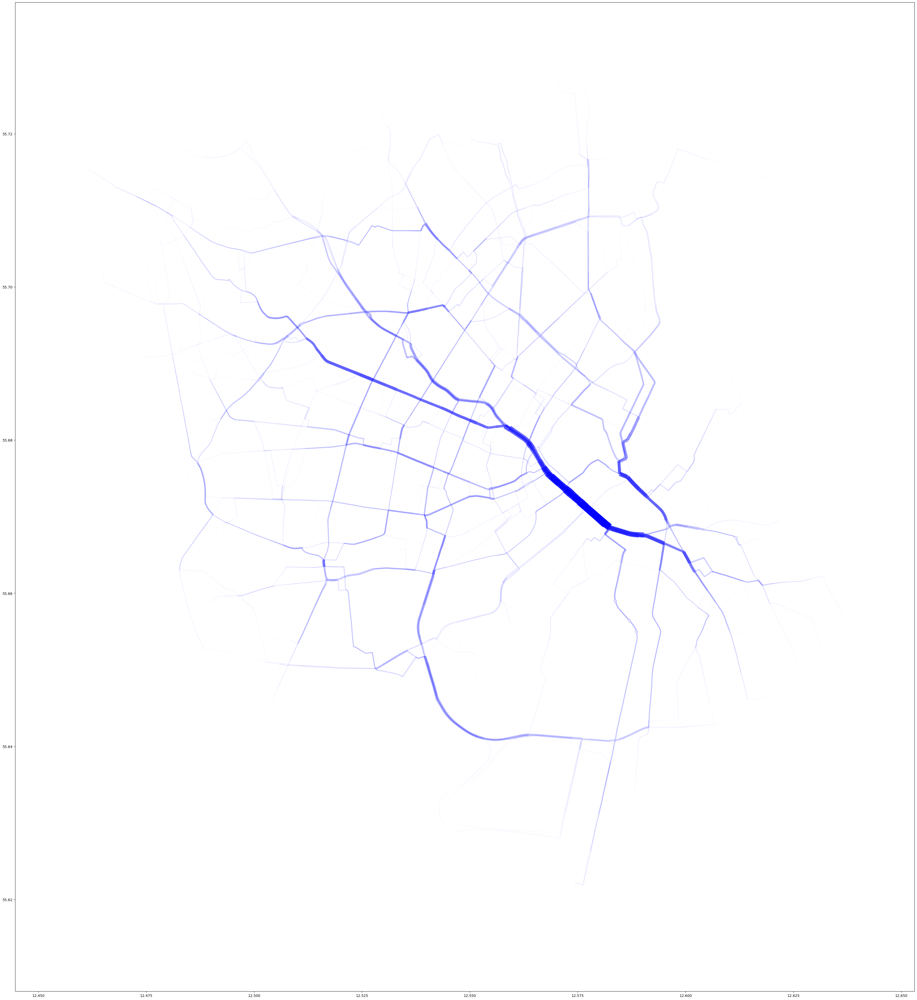

In [119]:
norm_btw(btw_length)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_length[k] for k in btw_length]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_length[k]*20 for k in btw_length]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [490]:
btw_bcount_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_attr')

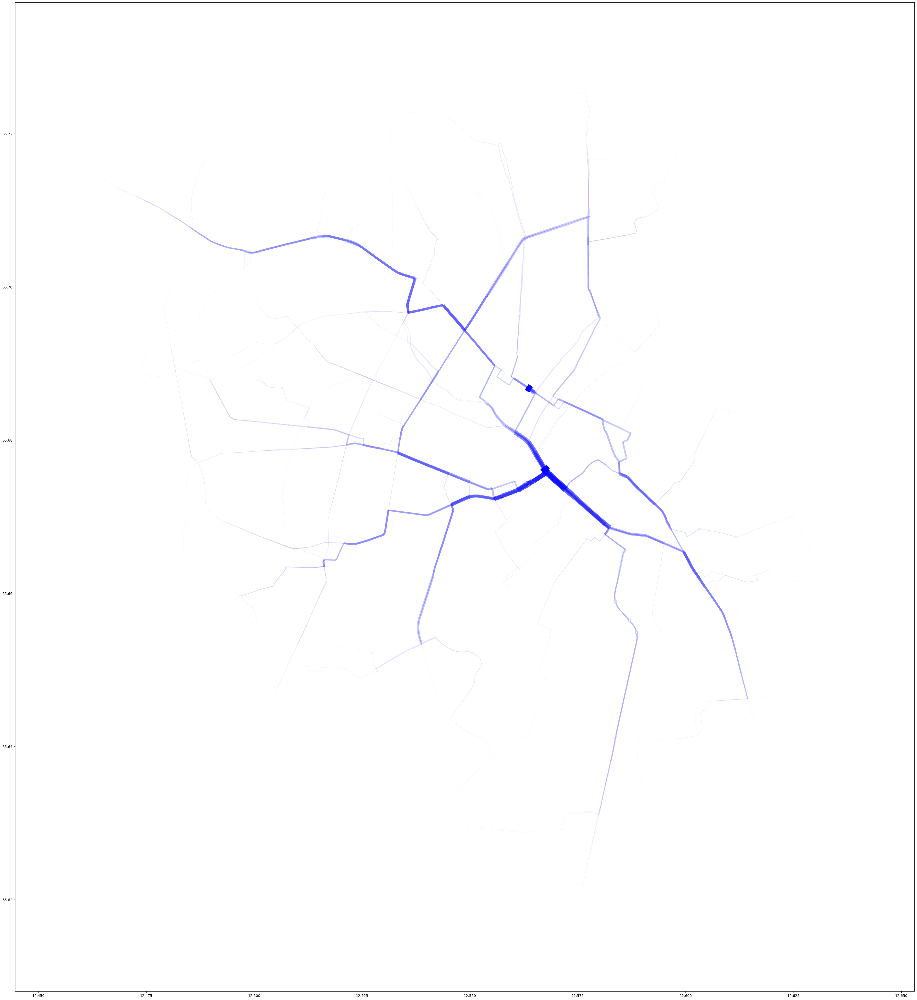

In [491]:
norm_btw(btw_bcount_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_attr[k] for k in btw_bcount_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_attr[k]*20 for k in btw_bcount_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [492]:
btw_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='pop_den_attr')

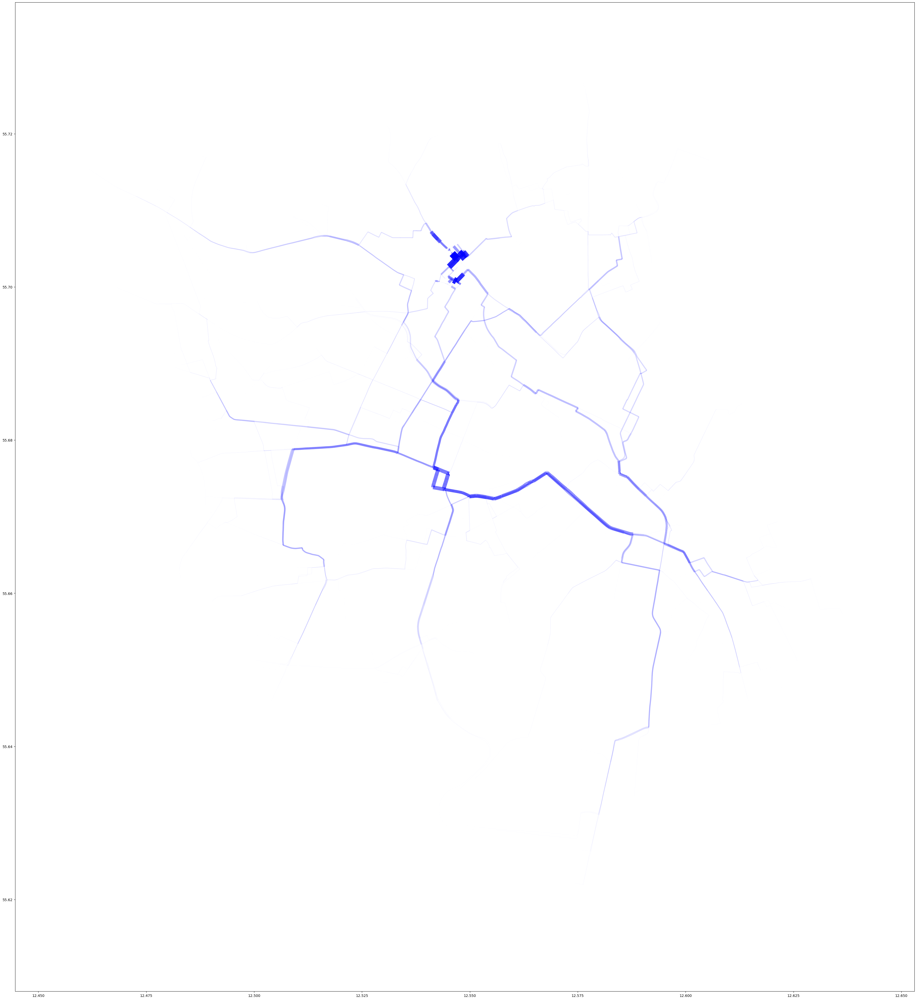

In [493]:
norm_btw(btw_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_pop_den_attr[k] for k in btw_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_pop_den_attr[k]*20 for k in btw_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [494]:
btw_bcount_pop_den_attr = nx.edge_betweenness_centrality(G_carall,  weight='bcount_pop_den_attr')

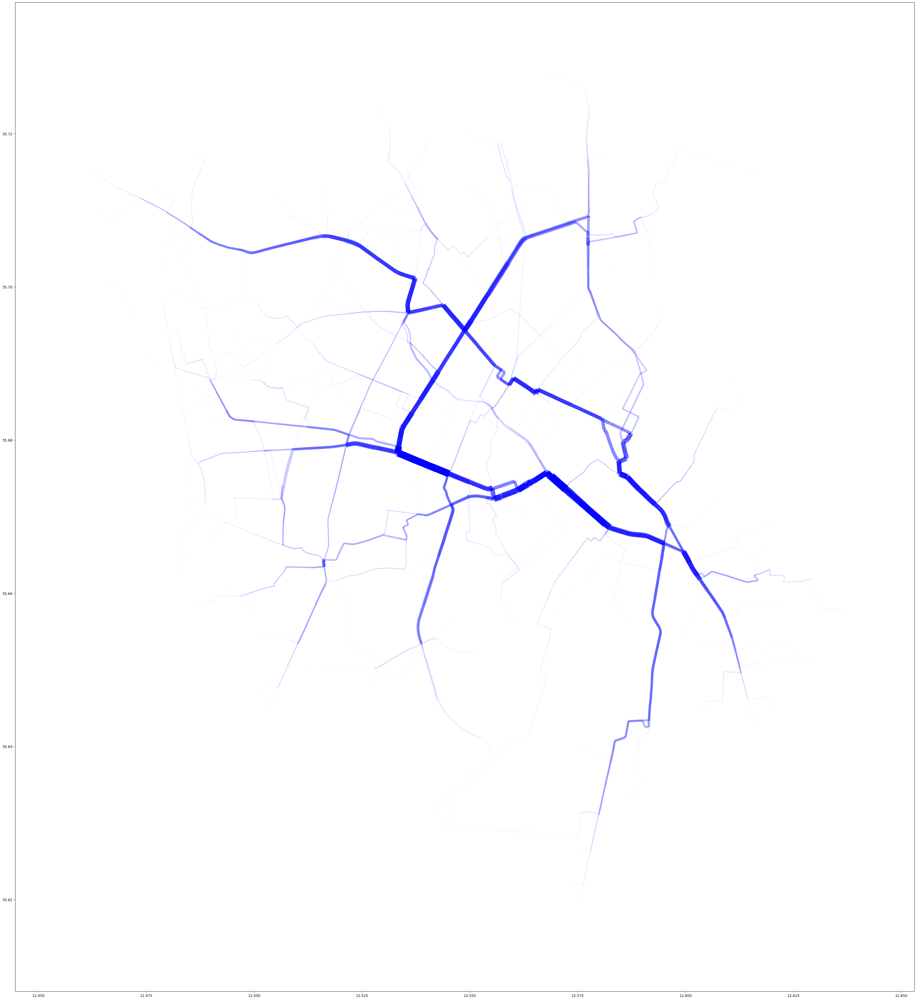

In [495]:
norm_btw(btw_bcount_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_pop_den_attr[k] for k in btw_bcount_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_pop_den_attr[k]*20 for k in btw_bcount_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

In [482]:
def norm_btw(d):
    fn = lambda value, x_max, x_min: (value - x_min) / (x_max - x_min)
    d_norm= d
    # In each inner dict

    # find min and max values
    max_x = max(d.values())
    min_x = min(d.values())

    # normalize each value in the dict
    for k in d:
        d_norm[k] = fn(d[k], max_x, min_x)

    return d_norm

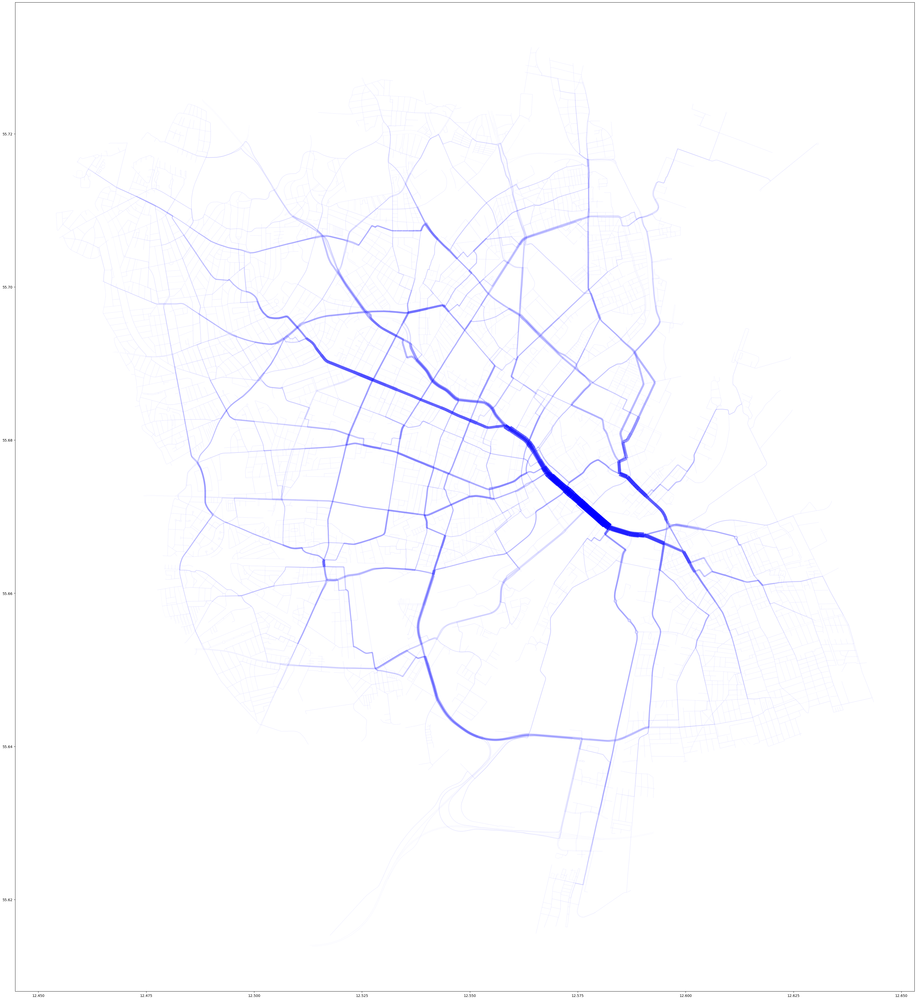

In [128]:
btw_length2 = btw_length.copy()
normalise_edge_dict2(btw_length2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_length2[k] for k in btw_length2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_length2[k]*20 for k in btw_length2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

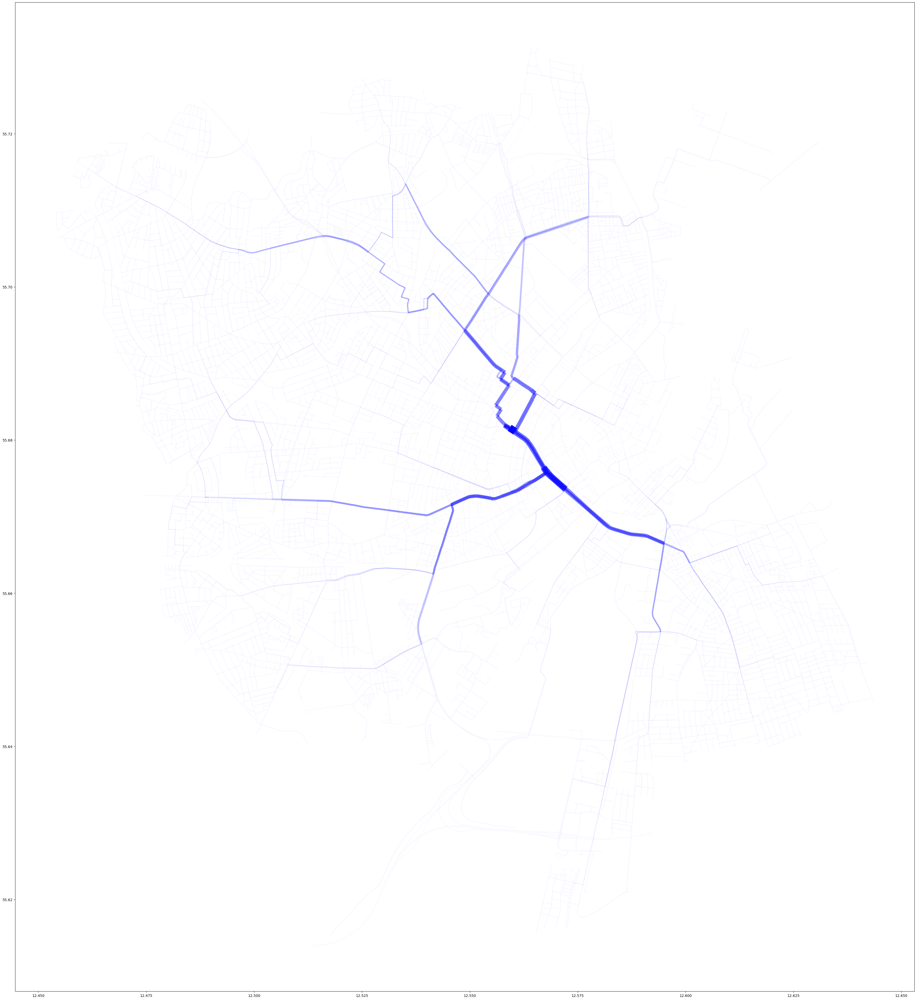

In [127]:
btw_bcount_attr2 = btw_bcount_attr.copy()
normalise_edge_dict2(btw_bcount_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_attr2[k] for k in btw_bcount_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_attr2[k]*20 for k in btw_bcount_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

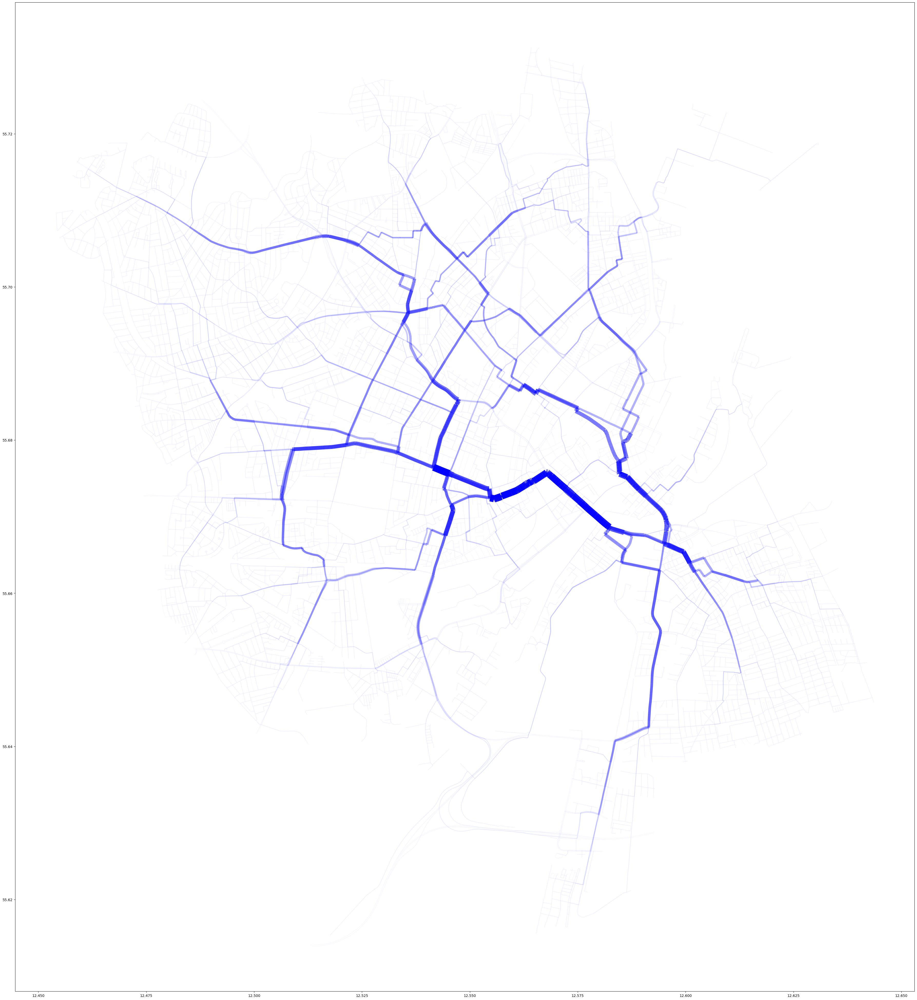

In [129]:
btw_pop_den_attr2 = btw_pop_den_attr.copy()
normalise_edge_dict2(btw_pop_den_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_pop_den_attr2[k] for k in btw_pop_den_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_pop_den_attr2[k]*20 for k in btw_pop_den_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

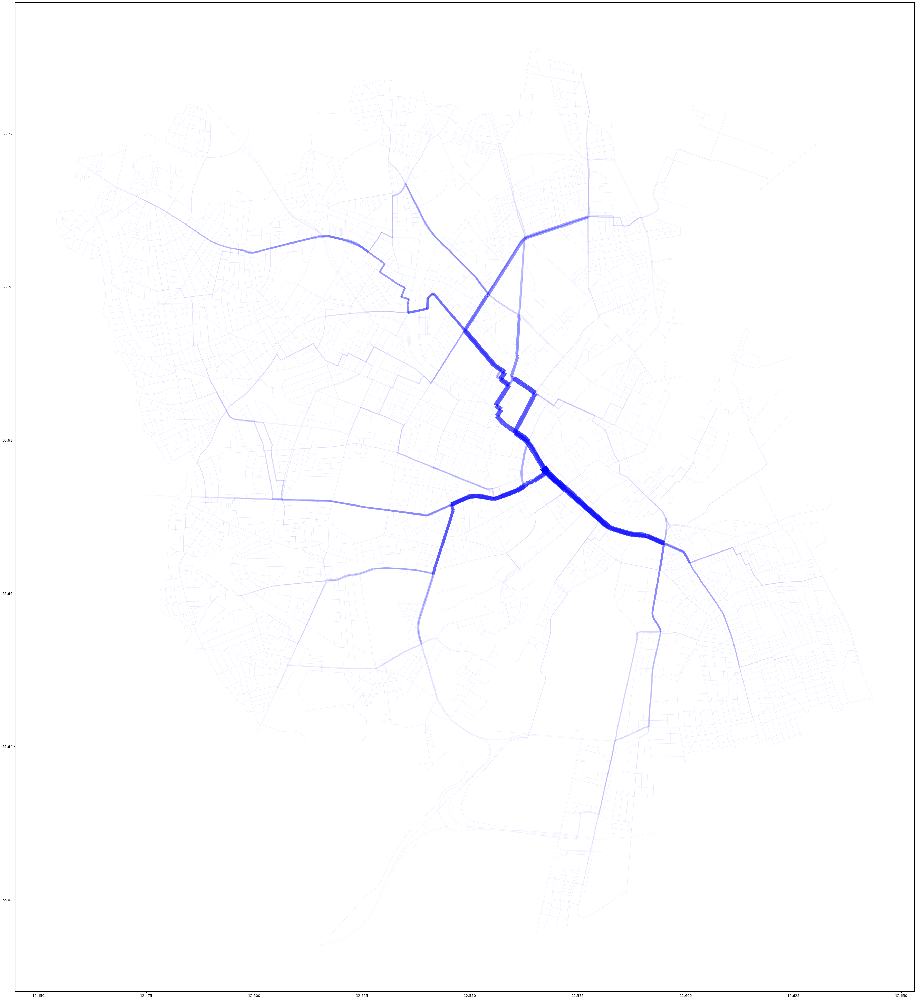

In [130]:
btw_bcount_pop_den_attr2 = btw_bcount_pop_den_attr.copy()
normalise_edge_dict2(btw_bcount_pop_den_attr2)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_pop_den_attr2[k] for k in btw_bcount_pop_den_attr2]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_pop_den_attr2[k]*20 for k in btw_bcount_pop_den_attr2]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

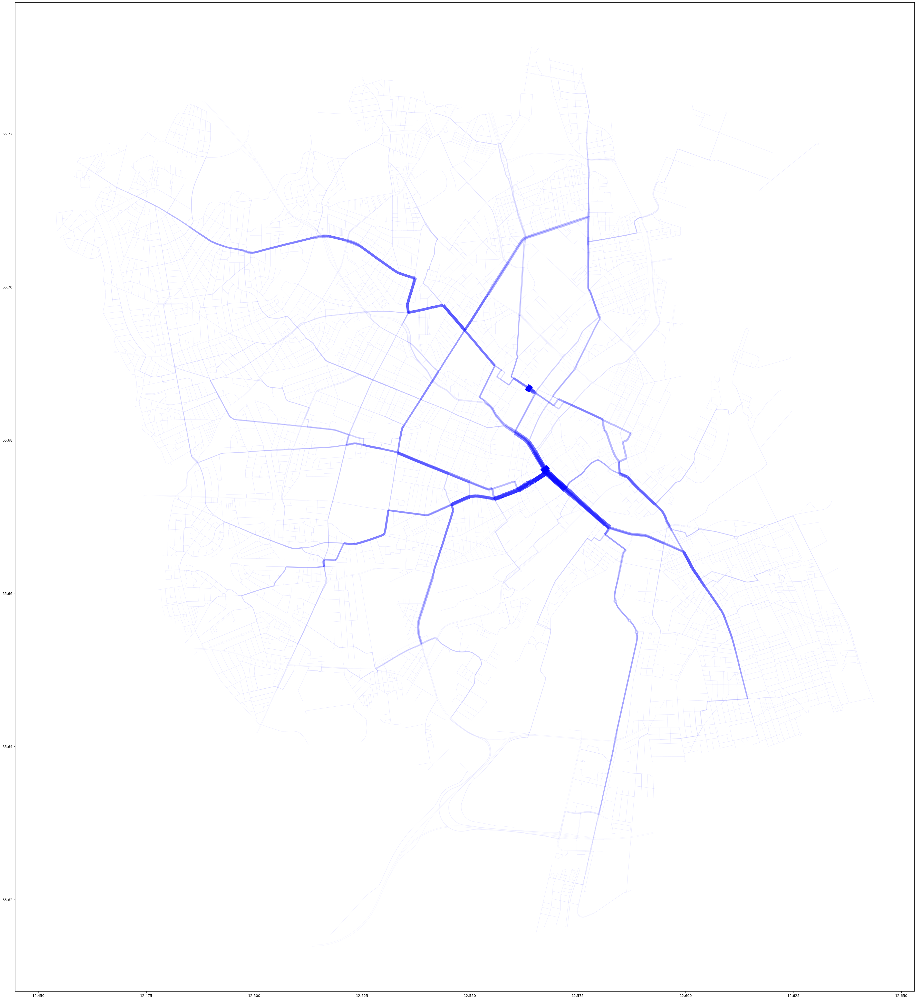

In [498]:
normalise_edge_dict(btw_bcount_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_attr[k] for k in btw_bcount_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_attr[k]*20 for k in btw_bcount_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

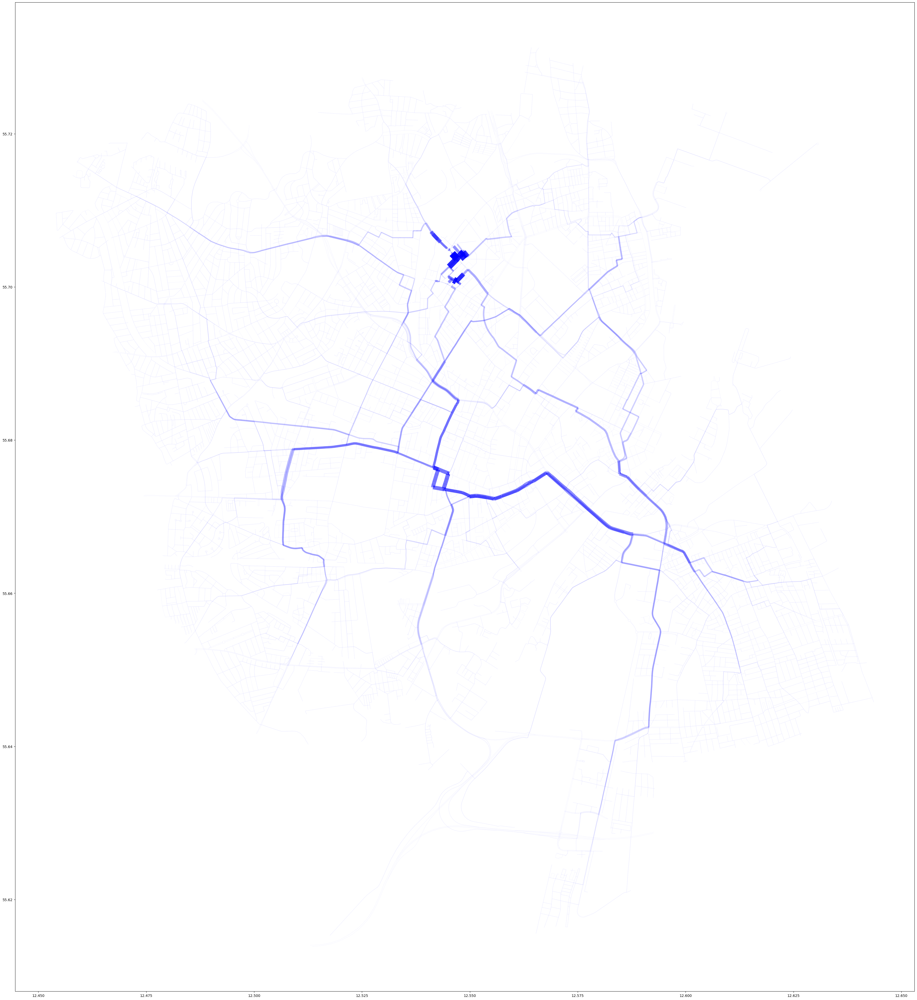

In [499]:
normalise_edge_dict(btw_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_pop_den_attr[k] for k in btw_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_pop_den_attr[k]*20 for k in btw_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()

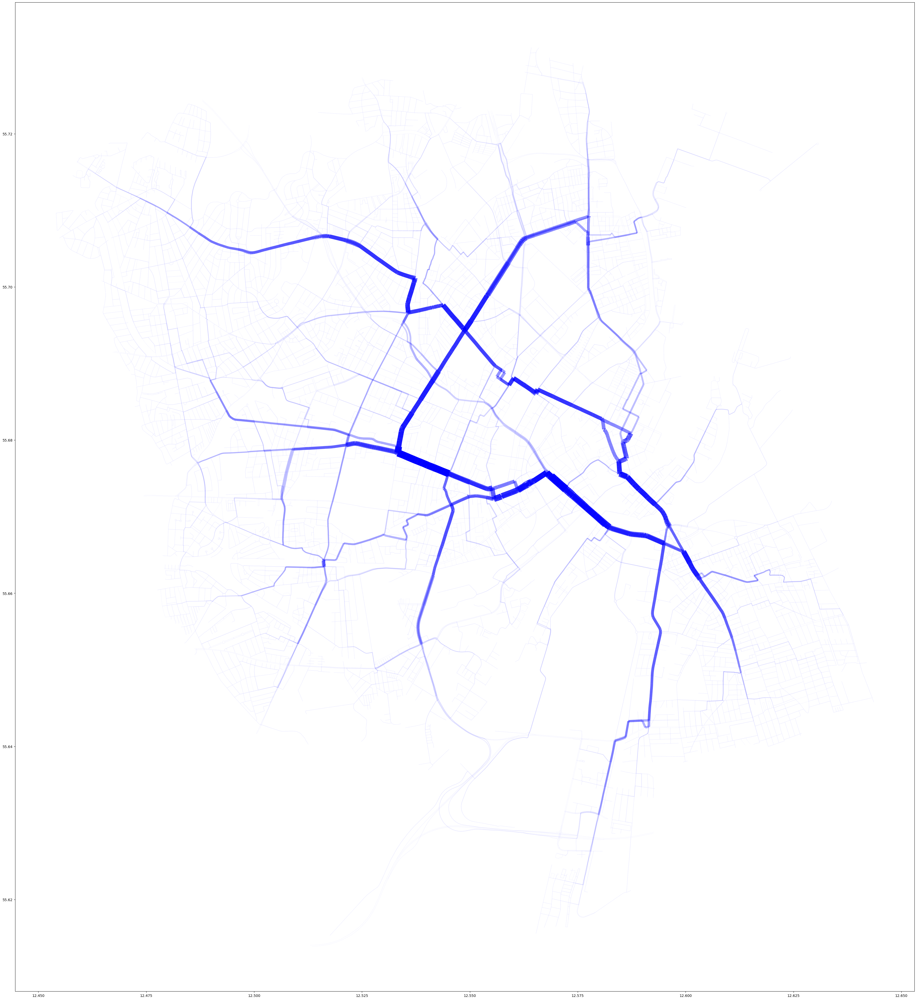

In [500]:
normalise_edge_dict(btw_bcount_pop_den_attr)

#This plot is edge betweenness centrality based on the 'bc_len_attr' attribute 
lanes = ox.graph_to_gdfs(G_carall, nodes=False)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


ac = [btw_bcount_pop_den_attr[k] for k in btw_bcount_pop_den_attr]
#ac = [0.08 if (edges_dict[k]) == meancountfraction else 0.8 for k in edges_dict]
lc = [btw_bcount_pop_den_attr[k]*20 for k in btw_bcount_pop_den_attr]

ax = world[world.name == "Copenhagen municipality"].plot(color='black', edgecolor='black', figsize=(50,50),bgcolor = 'black')
#bikelanes.plot(ax=ax, color='red')
lanes.plot(ax=ax, color='blue', alpha= ac, linewidth = lc)


plt.show()